In [ ]:
import os
import numpy as np
import argparse
import time
import numpy as np
import random
import pandas as pd
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split

import tensorflow as tf
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.models import model_from_json
from tensorflow.keras.preprocessing.image import ImageDataGenerator


import keras
from keras import backend as K

from keras.applications.mobilenet_v2 import MobileNetV2
from keras.models import Model, Sequential
from keras.layers import Dropout, UpSampling2D, Conv2D, MaxPooling2D, Activation, Input, concatenate, BatchNormalization
import cv2

from matplotlib import pyplot as plt
%matplotlib inline

In [ ]:
!pip install -U git+https://github.com/albu/albumentations --no-cache-dir;

  Cloning https://github.com/albu/albumentations to /tmp/pip-req-build-9cwn5x13
  Running command git clone -q https://github.com/albu/albumentations /tmp/pip-req-build-9cwn5x13
     |████████████████████████████████| 634kB 2.8MB/s 
  Created wheel for albumentations: filename=albumentations-0.4.5-cp36-none-any.whl size=65168 sha256=f638eb561673f2442651ffced799a5264b59fc3b5cfd0531614613bd05c8ab4c
  Stored in directory: /tmp/pip-ephem-wheel-cache-xuez6k04/wheels/45/8b/e4/2837bbcf517d00732b8e394f8646f22b8723ac00993230188b
  Created wheel for imgaug: filename=imgaug-0.2.6-cp36-none-any.whl size=654020 sha256=981f1abd939931d3d8ccd460ac1558d3c9d20bb0dca0c8cdb41be960b7ac6b88
  Stored in directory: /tmp/pip-ephem-wheel-cache-xuez6k04/wheels/97/ec/48/0d25896c417b715af6236dbcef8f0bed136a1a5e52972fc6d0
Successfully built albumentations imgaug
  Found existing installation: imgaug 0.2.9
    Uninstalling imgaug-0.2.9:
      Successfully uninstalled imgaug-0.2.9
  Found existing installation: album

In [ ]:
pip install segmentation-models;

In [ ]:
import segmentation_models as sm
import albumentations as A

Segmentation Models: using `keras` framework.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')
# Google colab

In [ ]:
image_train_dir = r'/content/drive/My Drive/laser_track/main'
mask_train_dir = r'/content/drive/My Drive/laser_track/mask'

## Test generator

In [ ]:
path_test_image = r'/content/drive/My Drive/laser_track/test/'

In [ ]:
def adjust_data_test(mask):
    mask[mask > 0.1] = 255
    mask[mask <= 0.1] = 0
    return mask


seed = 1
batch_size_test = 4

test_image_datagen = ImageDataGenerator(rescale=1. / 255)
test_mask_datagen = ImageDataGenerator(rescale=1. / 255,
                                       preprocessing_function=adjust_data_test)

test_generator_image = test_image_datagen.flow_from_directory(
    path_test_image,
    classes=['main'],
    target_size=(512, 512),
    batch_size=batch_size_test,
    class_mode=None,
    seed=seed)

test_generator_mask = test_mask_datagen.flow_from_directory(
    path_test_image,
    classes=['mask'],
    target_size=(512, 512),
    batch_size=batch_size_test,
    class_mode=None,
    color_mode="grayscale",
    seed=seed)


Found 33 images belonging to 1 classes.
Found 33 images belonging to 1 classes.


In [ ]:
test_generator = zip(test_generator_image, test_generator_mask)

In [ ]:
np.unique(test_generator_mask[0][0])

array([0., 1.], dtype=float32)

In [ ]:
def test_visualize(test_generator_image=test_generator_image, test_generator_mask=test_generator_mask):
    random.seed(4)
    batch_size = test_generator_image.batch_size
    number = random.randrange(test_generator_image.samples // batch_size)
    fig, axes = plt.subplots(batch_size, 2, figsize=(30, 30))
    for i, image_mask in enumerate(zip(test_generator_image[number], test_generator_mask[number])):
        axes[i, 0].set_title("origin image")
        axes[i, 0].imshow(image_mask[0])
        axes[i, 1].set_title("origin mask")
        axes[i, 1].imshow(image_mask[1].squeeze())


def model_test_visualize(model, seed = 2, test_generator_image=test_generator_image, test_generator_mask=test_generator_mask):
    random.seed(seed)
    batch_size = test_generator_image.batch_size
    number = random.randrange(test_generator_image.samples // batch_size)
    fig, axes = plt.subplots(batch_size, 3, figsize=(35, 35))
    predict = model.predict(test_generator_image[number])
    for i, image_mask in enumerate(zip(test_generator_image[number], test_generator_mask[number])):
        axes[i, 0].set_title("origin image")
        axes[i, 0].imshow(image_mask[0])
        axes[i, 1].set_title("origin mask")
        axes[i, 1].imshow(image_mask[1].squeeze())
        axes[i, 2].set_title("predicted")
        axes[i, 2].imshow(predict[i].squeeze() > 0.5)


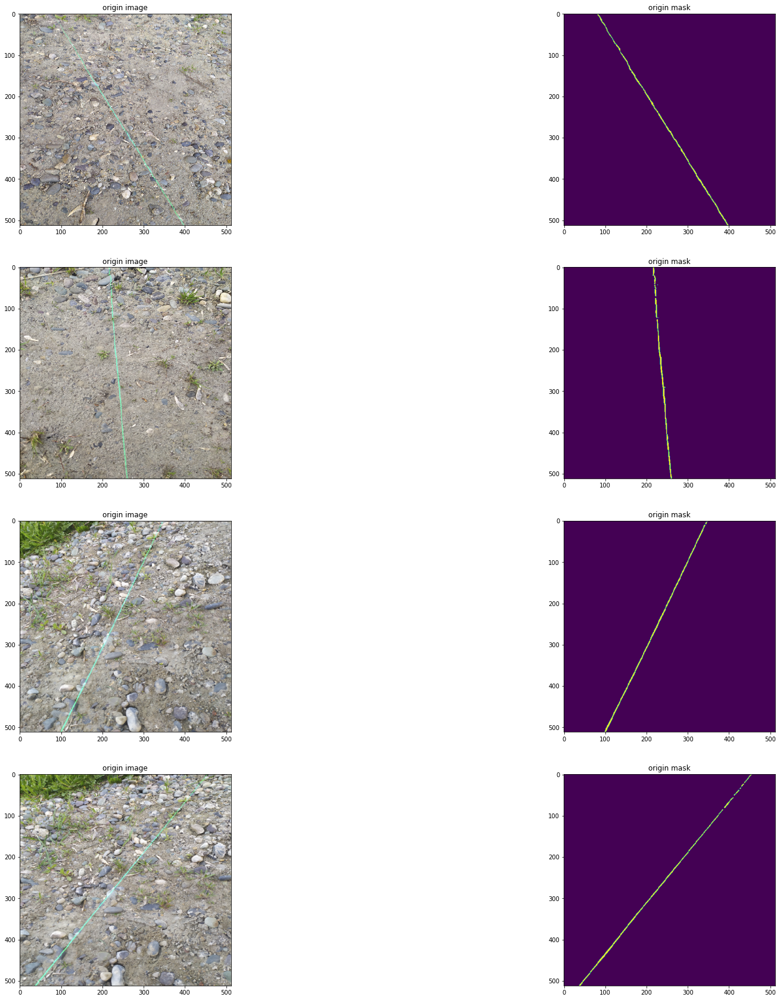

In [ ]:
test_visualize()

## Image aug in Keras

In [ ]:
# Create image generator using Keras

In [ ]:
path_drive = r'/content/drive/My Drive/laser_track'

In [ ]:
# def img_morth(inp_arr):

#   image1copy = np.uint8(inp_arr)
#   kernel = np.ones((3,3),np.uint8)
#   opening = cv2.morphologyEx(image1copy, cv2.MORPH_OPEN, kernel)
#   blur = cv2.GaussianBlur(opening,(1,1),0)
#   opening = cv2.morphologyEx(blur, cv2.MORPH_CLOSE,kernel)
#   #opening = np.float32(opening)
#   opening = np.float32(opening)
#   return  cv2.merge((opening,np.array(1)))


# def img_mask_morth(inp_arr):

#   kernel = np.ones((3,3),np.uint8)
#   image1copy = np.uint8(inp_arr)
#   image1copy = np.float32(image1copy)
#   return cv2.merge((image1copy,np.array(1)))

def random_color(image):
    # DILATE_KERNEL = np.ones((7, 7), np.uint8)
    # mask_dilate = cv2.dilate(mask, DILATE_KERNEL, iterations=1)
    # mask = mask_dilate
    colo_bgr = cv2.split(image)
    image = cv2.merge(random.sample(colo_bgr, 3))
    # mask = np.reshape(mask, mask.shape + (1,))
    image = np.float32(image)
    return image


def adjust_data(mask):
    # DILATE_KERNEL = np.ones((7, 7), np.uint8)
    # mask_dilate = cv2.dilate(mask, DILATE_KERNEL, iterations=1)
    # mask = mask_dilate
    mask[mask > 0.5] = 255
    mask[mask <= 0.5] = 0
    mask = np.float32(mask)
    # mask = np.reshape(mask, mask.shape + (1,))
    return mask


In [ ]:
seed = 1
batch_size = 4

# data_gen_args = dict(rescale=1./255,
#     featurewise_center=True,
#     rotation_range=30,
#     shear_range=0.1,
#     width_shift_range=0.1,
#     height_shift_range=0.1,
#     zoom_range=0.1,
#     brightness_range = [0.5, 1.5],
#     horizontal_flip=True,
#     validation_split=0.2)

image_datagen = ImageDataGenerator(rescale=1. / 255,
                                   featurewise_center=True,
                                   rotation_range=0.5,
                                   fill_mode='nearest',
                                   width_shift_range=0.1,
                                   height_shift_range=0.1,
                                   shear_range=0.1,
                                   zoom_range=0.1,
                                   horizontal_flip=True,
                                   validation_split=0.2,
                                   preprocessing_function=random_color)

mask_datagen = ImageDataGenerator(rescale=1. / 255,
                                  featurewise_center=True,
                                  rotation_range=0.5,
                                  fill_mode='nearest',
                                  width_shift_range=0.1,
                                  height_shift_range=0.1,
                                  shear_range=0.1,
                                  zoom_range=0.1,
                                  horizontal_flip=True,
                                  validation_split=0.2,
                                  preprocessing_function=adjust_data)

#
mask_v_datagen = ImageDataGenerator(rescale=1. / 255,
                                    featurewise_center=True,
                                    rotation_range=0.5,
                                    fill_mode='nearest',
                                    width_shift_range=0.1,
                                    height_shift_range=0.1,
                                    shear_range=0.1,
                                    zoom_range=0.1,
                                    horizontal_flip=True,
                                    validation_split=0.2,
                                    preprocessing_function=adjust_data)
#


In [ ]:
image_generator = image_datagen.flow_from_directory(
    path_drive,
    target_size=(512, 512),
    classes=['main'],
    batch_size=batch_size,
    subset='training',
    class_mode=None,
    seed=seed)

mask_generator = mask_datagen.flow_from_directory(
    path_drive,
    target_size=(512, 512),
    classes=['mask'],
    batch_size=batch_size,
    subset='training',
    class_mode=None,
    seed=seed)
#  color_mode="grayscale",


Found 236 images belonging to 1 classes.
Found 236 images belonging to 1 classes.


In [ ]:
validation_generator = image_datagen.flow_from_directory(
    path_drive,
    target_size=(512, 512),
    classes = ['main'],
    batch_size=batch_size,
    subset='validation',
    class_mode=None,
    seed=seed) # set as validation data

validation_mask_generator = mask_v_datagen.flow_from_directory(
    path_drive,
    target_size=(512, 512),
    classes = ['mask'],
    batch_size=batch_size,
    subset='validation',
    class_mode=None,
    seed=seed) # set as validation data

Found 58 images belonging to 1 classes.
Found 58 images belonging to 1 classes.


In [ ]:
# combine generators into one, which yields image and masks
train_generator = zip(image_generator, mask_generator)
valid_generator = zip(validation_generator, validation_mask_generator)

## Image aug 


### Collect Data

Create own image generator for training

In [ ]:
def history_visualize(history, name = 'Resnet50'):
  fig, axes = plt.subplots(3, 1, figsize=(14, 14))
  axes[0].set_title('{} iou_score'.format(name), fontsize=14)
  axes[0].set_ylabel('iou_score', fontsize=14)
  axes[0].plot(history.history['iou_score'])
  axes[0].plot(history.history['val_iou_score'])
  axes[0].legend(['Train data', 'Validation data'], loc='upper left')


  axes[1].set_title('{} Focal Dice loss'.format(name), fontsize=14)
  axes[1].set_ylabel('Loss', fontsize=14)
  axes[1].plot(history.history['loss'])
  axes[1].plot(history.history['val_loss'])
  axes[1].legend(['Train data', 'Validation data'], loc='upper left', fontsize=14)

  axes[2].set_title('{} f1-score'.format(name), fontsize=14)
  axes[2].set_ylabel('f1-scores', fontsize=14)
  axes[2].set_xlabel('epoch', fontsize=14)
  axes[2].plot(history.history['f1-score'])
  axes[2].plot(history.history['val_f1-score'])
  axes[2].legend(['Train data', 'Validation data'], loc='upper left', fontsize=14)
  
  plt.show()

In [ ]:
def visualize(*my_dict, **images):
    if images:
        n = len(images)
        ind = True
    else:
        n = len(my_dict[0])
        images = my_dict[0]
        ind = False
    plt.figure(figsize=(20, 20))
    for i, (name, image) in enumerate(images.items()):
        if ind:
            plt.subplot(n // 2, 2, i + 1)
        else:
            plt.subplot(n // 4, 4, i + 1)
        plt.title(' '.join(name.split('_')).title())
        if image.shape[-1] == 3:
            plt.imshow(image)
        else:
            plt.imshow(image.squeeze())

    plt.show()


In [ ]:
# Closes what save validation split  in ImageDataset
class ImageDataset:
    """ Read image, augmenting and preprocessing
  
     Args:
         images_path: path to images dir
         image_,mask_path: path to mask dir
         train_or_validation: validation or train
         augmentation: (albumentations.Compose): data transfromation pipeline 
              (e.g. flip, scale, etc.)
         preprocessing: (albumentations.Compose): data preprocessing 
              (e.g. noralization, shape manipulation, etc.) """
    closure_imageDataset = False

    @classmethod
    def dataset_prepare(cls, validation_split, train_or_validation):
        __images = [os.path.join(image_train_dir, image_id) for image_id in sorted(os.listdir(image_train_dir),
                                                                                   key=lambda name: int(
                                                                                       name.split('.')[0]))]
        __maskes = [os.path.join(mask_train_dir, image_id) for image_id in sorted(os.listdir(mask_train_dir),
                                                                                  key=lambda name: int(
                                                                                      name.split('-')[0]))]
        cls.closure_imageDataset = True
        # im_train, im_valid, ms_train, ms_valid =                                                                         
        return train_test_split(__images, __maskes, test_size=validation_split, shuffle=True)

    def __init__(self, image_path, mask_path,
                 augmentation=None, preprocessing=None, validation_split=0.2, train_or_validation=None):
        if not self.__class__.closure_imageDataset:
            # split data on train and validation 
            self.__class__.im_train, self.__class__.im_valid, self.__class__.ms_train, self.__class__.ms_valid = ImageDataset.dataset_prepare(
                validation_split, train_or_validation)
        if train_or_validation == 'train':
            self.__images = self.__class__.im_train
            self.__maskes = self.__class__.ms_train
        elif train_or_validation == 'validation':
            self.__images = self.__class__.im_valid
            self.__maskes = self.__class__.ms_valid
        else:
            raise ValueError("train_or_validation must be 'train' or 'validation'")
        self.__augmentation = augmentation
        self.__preprocessing = preprocessing

    def __len__(self):
        return len(self.__images)

    def __getitem__(self, i):

        # read data
        image = cv2.imread(self.__images[i])
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        mask = cv2.imread(self.__maskes[i], 0)
        image = cv2.resize(image, (512, 512), interpolation=cv2.INTER_CUBIC)
        mask = cv2.resize(mask, (512, 512), interpolation=cv2.INTER_CUBIC)

        # apply augmentations
        if self.__augmentation:
            sample = self.__augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']

        # apply preprocessing
        if self.__preprocessing:
            sample = self.__preprocessing(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']

            # need reshape mask and binarize
        image = image / 255
        mask = mask / 255
        mask[mask > 0.3] = 1.
        mask[mask <= 0.3] = 0.
        mask = np.reshape(mask, mask.shape + (1,))

        return image, mask


In [ ]:
# From qubvel

class Dataloder(keras.utils.Sequence):
    """Load data from dataset and form batches
  
      Args:
          dataset: instance of Dataset class for image loading and preprocessing.
          batch_size: Integet number of images in batch.
          shuffle: Boolean, if `True` shuffle image indexes each epoch.
      """

    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.__dataset = dataset
        self.__batch_size = batch_size
        self.__shuffle = shuffle
        self.__indexes = np.arange(len(dataset))

        self.on_epach_end()

    def __getitem__(self, i):

        # collect batch data
        start = i * self.__batch_size
        end = (i + 1) * self.__batch_size
        data = []

        for j in range(start, end):
            data.append(self.__dataset[j])
        # transpose list of lists

        batch = [np.stack(samples, axis=0) for samples in zip(*data)]

        return batch

    def __len__(self):
        """Denotes the number of batches per epoch"""
        return len(self.__indexes) // self.__batch_size

    def on_epach_end(self):
        """Callback function to shuffle indexes each epoch"""
        if self.__shuffle:
            self.__indexes = np.random.permutation(self.__indexes)


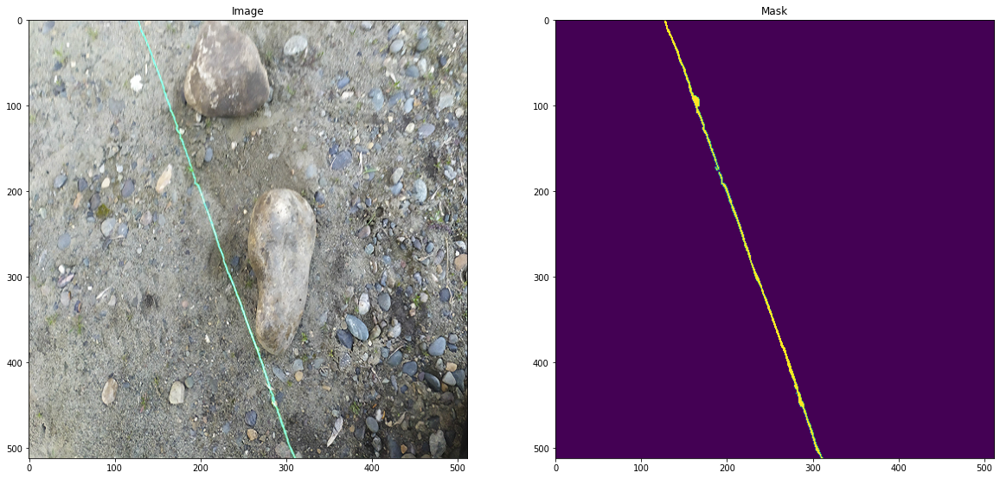

In [ ]:
# Lets look at data what we have
dataset1 = ImageDataset(image_train_dir, mask_train_dir, train_or_validation='train')

image, mask = dataset1[15]  # get some sample

visualize(
    image=image,
    mask=mask,
)


### Augmentation in  Albumentations

Here we perform different augmentations based on different transformations

In [ ]:
def round_clip_0_1(x, **kwargs):
    return x.round().clip(0, 1)

# define heavy augmentations
def get_training_augmentation():
    train_transform = [

        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
        
        A.RandomRotate90(p=0.5),
        A.ChannelShuffle( always_apply = False , p = 0.5 ),
        
         A.Compose( 
             [
             A.RandomCrop(random.randint(256,512), random.randint(256,512), always_apply=False, p=1),
             A.Resize(512, 512, interpolation=1, always_apply=False, p=1)
             

             ],
             p = 0.3,
         ),

         A.OneOf(
             [
                  A.ElasticTransform(alpha=1, sigma=50, alpha_affine=50, interpolation=1,
                                 border_mode=4, value=None, mask_value=None, always_apply=False, approximate=False, p=0.5),
                  A.MaskDropout(max_objects=1, image_fill_value=0, mask_fill_value=0, always_apply=False, p=0.5),
              
              
             ],
             p=0.5,
         ),

        A.OneOf(
             [
                 A.RGBShift(r_shift_limit=20, g_shift_limit=20, b_shift_limit=20, always_apply=False, p=0.5),
                 A.HueSaturationValue(hue_shift_limit=15, sat_shift_limit=20, val_shift_limit=15, always_apply=False, p=0.5) 
             ],
             p=0.5,
         ),


        A.OneOf(
             [
                 A.ShiftScaleRotate(shift_limit=1, scale_limit=0.3, 
                                                    rotate_limit=45, interpolation=1, border_mode = 4, 
                                                    value=None, mask_value=None, always_apply=False, p=0.5),
                 A.GridDistortion(num_steps=5, distort_limit=0.3, interpolation=1, border_mode=4, value=None,
                                  mask_value=None, always_apply=False, p=0.5) 
             ],
             p=0.5,
         ),

         A.OneOf(
             [
                 A.CLAHE(clip_limit=4.0, tile_grid_size=(8, 8), always_apply=False, p=0.5),
                 A.RandomSnow(snow_point_lower=0.1, snow_point_upper=0.3, brightness_coeff=2.5, always_apply=False, p=0.5),
                 A.RandomShadow(shadow_roi=(0, 0.5, 1, 1), num_shadows_lower=1, num_shadows_upper=2, shadow_dimension=5, always_apply=False, p=0.5),
                 A.RandomBrightness(limit=0.05, always_apply=False, p=0.5)
             ],
             p=0.5,
         ),

        A.OneOf(
            [
                A.ToSepia( always_apply = False , p = 0.2 ),
                A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.2, brightness_by_max=True, always_apply=False, p=0.5),
                A.FancyPCA(alpha=0.1, always_apply=False, p=0.5)

            ],
            p=0.5,
        ),

        A.OneOf(
            [
                A.CoarseDropout(max_holes = 8 , max_height = 8 , max_width = 8, 
                                min_holes = None , min_height = None , min_width = None , fill_value = random.randint(0, 255) , always_apply = False , p = 0.5),
                A.RandomRain(slant_lower=-10, slant_upper=10, drop_length=20, drop_width=1, 
                             drop_color=(200, 200, 200), blur_value=7, brightness_coefficient=0.7, rain_type=None, always_apply=False, p=0.5),
                A.HueSaturationValue(hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=20, always_apply=False, p=0.5),
                A.RandomContrast(limit=0.05, always_apply=False, p=0.5)
            ],
            p=0.5,
        ),
         A.PadIfNeeded(min_height=512, min_width=512, always_apply=True),
    ]
    return A.Compose(train_transform)


def get_validation_augmentation():
    """Add paddings to make image shape divisible by 32"""
    test_transform = [
        A.PadIfNeeded(512,512),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
        A.RandomRotate90(p=0.5)
    ]
    return A.Compose(test_transform)

def get_preprocessing(preprocessing_fn):
    """Construct preprocessing transform
    
    Args:
        preprocessing_fn (callbale): data normalization function 
            (can be specific for each pretrained neural network)
    Return:
        transform: albumentations.Compose
    
    """
    
    _transform = [
        A.Lambda(image=preprocessing_fn),
    ]
    
    return A.Compose(_transform)

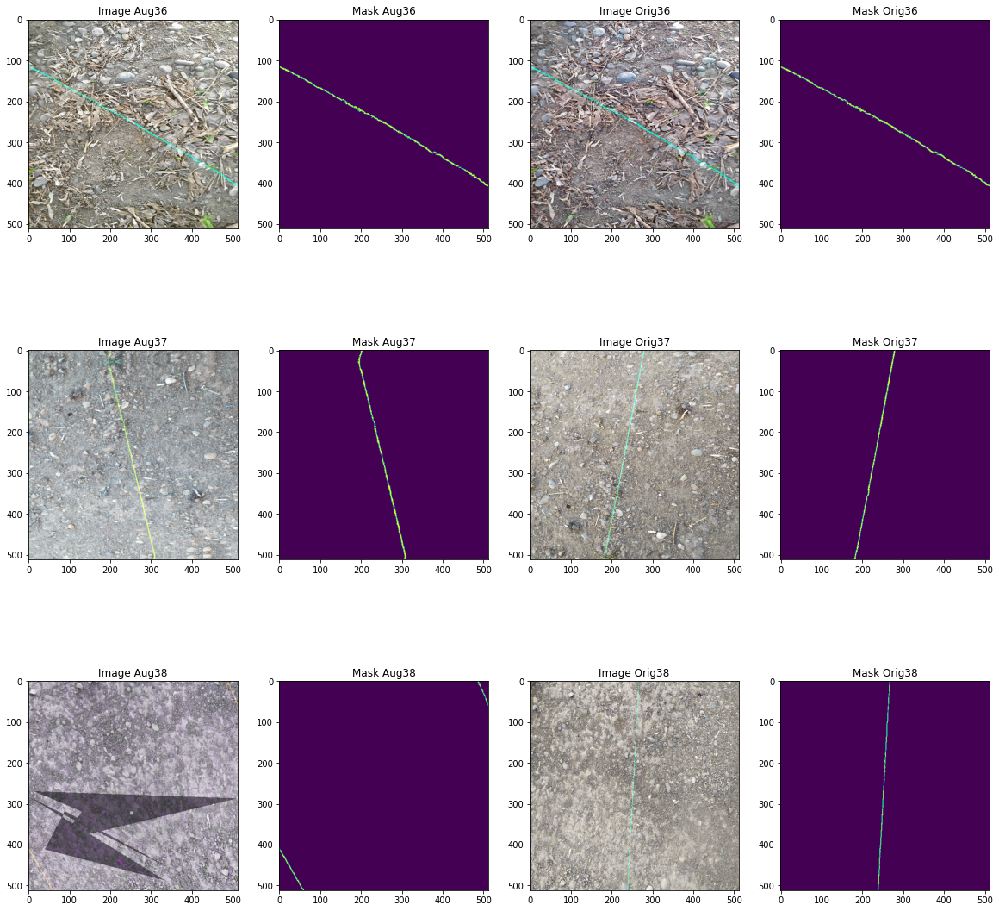

In [ ]:
# Lets look at data we have
dataset = ImageDataset(image_train_dir, mask_train_dir, train_or_validation = 'train', augmentation=get_training_augmentation())
dataset_1 =  ImageDataset(image_train_dir, mask_train_dir, train_or_validation = 'train')
visual_aug = {}

# What image do you want to see, write their indexes in range
for i in range(36,39,1):
  image, mask = dataset[i]
  image1, mask1 = dataset_1[i]
  visual_aug['image_aug{}'.format(i)] = image
  visual_aug['mask_aug{}'.format(i)] = mask
  visual_aug['image_orig{}'.format(i)] = image1
  visual_aug['mask_orig{}'.format(i)] = mask1
visualize(visual_aug)

In [ ]:
# Preparing Dataset
BATCH_SIZE = 3


In [ ]:
# Dataset for train images

train_dataset = ImageDataset(
    image_train_dir, 
    mask_train_dir,  
    augmentation=get_training_augmentation(),
    train_or_validation = 'train'
)

# Dataset for validation images
valid_dataset = ImageDataset(
    image_train_dir, 
    mask_train_dir,  
    augmentation=get_validation_augmentation(),
    train_or_validation = 'validation'
)

train_dataloader = Dataloder(train_dataset, batch_size=BATCH_SIZE, shuffle=False)
valid_dataloader = Dataloder(valid_dataset, batch_size=BATCH_SIZE, shuffle=False)

# assert train_dataloader[0][0].shape == (BATCH_SIZE, 512, 512, 3)
# assert train_dataloader[0][1].shape == (BATCH_SIZE, 512, 512, 1)



## resnet50 with unet

In [ ]:
#define network parameters
model_first = sm.Unet('resnet50',input_shape=(512, 512, 3), classes=1, encoder_weights=r'imagenet', activation='sigmoid' ) 


In [ ]:
model_first.layers

In [ ]:
model_first.summary()

Model: "model_8"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
data (InputLayer)               (None, 512, 512, 3)  0                                            
__________________________________________________________________________________________________
bn_data (BatchNormalization)    (None, 512, 512, 3)  9           data[0][0]                       
__________________________________________________________________________________________________
zero_padding2d_37 (ZeroPadding2 (None, 518, 518, 3)  0           bn_data[0][0]                    
__________________________________________________________________________________________________
conv0 (Conv2D)                  (None, 256, 256, 64) 9408        zero_padding2d_37[0][0]          
____________________________________________________________________________________________

In [ ]:
# define callbacks for learning rate scheduling and best checkpoints saving
checkpoint_path = r"/content/drive/My Drive/laser_track/2resnet50.hdf5"
callbacks = [
    keras.callbacks.ModelCheckpoint(checkpoint_path, save_best_only=True, mode='min'),
    keras.callbacks.ReduceLROnPlateau(),
    keras.callbacks.EarlyStopping(monitor='iou_score', patience=40, verbose=0, mode='max')
]

optim = keras.optimizers.Adam(lr=0.0003)


dice_loss = sm.losses.DiceLoss()
focal_loss = sm.losses.BinaryFocalLoss()
total_loss = dice_loss + (1 * focal_loss)



metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5)]

# compile keras model with defined optimozer, loss and metrics
model_first.compile(optim, total_loss, metrics)
#model_first.load_weights(checkpoint_path)

In [ ]:
history_first = model_first.fit_generator(
    train_dataloader,
    steps_per_epoch=len(train_dataloader),
    epochs=2,
    callbacks=callbacks,
    validation_data=valid_dataloader,
    validation_steps=len(valid_dataloader),
    class_weight=None,
    # max_queue_size=10,
    # workers=4,
    # validation_freq=1,
    # use_multiprocessing=True,
    shuffle=True,
    initial_epoch=0)


Epoch 1/2
78/78 [==============================] - 349s 4s/step - loss: 1.0269 - iou_score: 0.1977 - f1-score: 0.3077 - val_loss: 1.0138 - val_iou_score: 7.6501e-05 - val_f1-score: 1.5278e-04
Epoch 2/2
78/78 [==============================] - 49s 630ms/step - loss: 0.9213 - iou_score: 0.3825 - f1-score: 0.5435 - val_loss: 0.9933 - val_iou_score: 1.7648e-09 - val_f1-score: 1.7648e-09


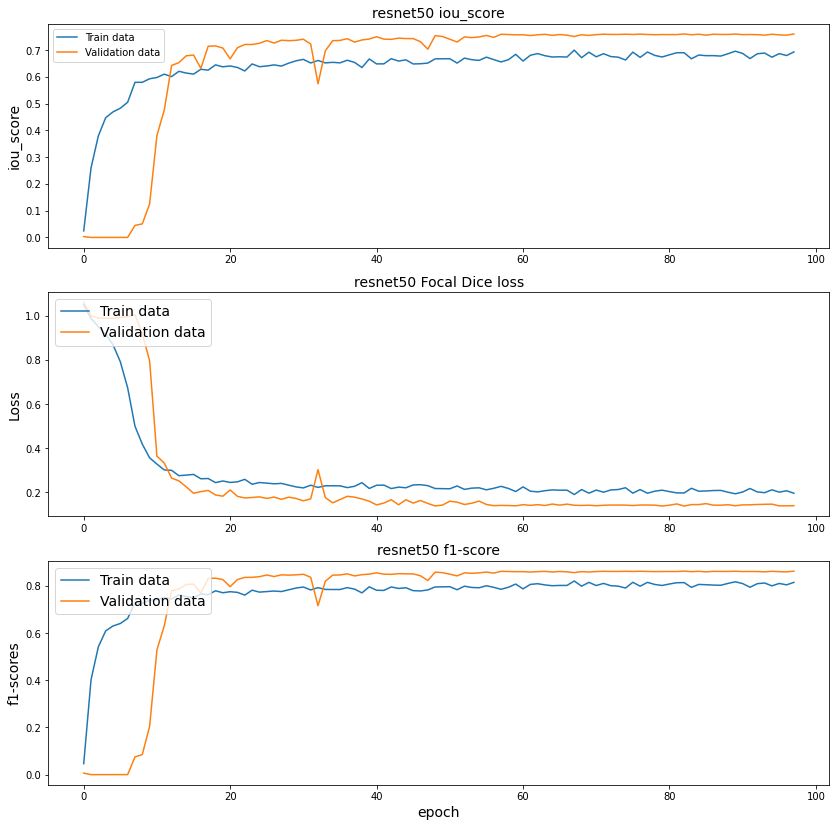

In [ ]:
history_visualize(history_first,'resnet50')

In [ ]:

# convert the history.history dict to a pandas DataFrame:     
hist_df = pd.DataFrame(history_first.history) 

# save to json:  
hist_json_file = '/content/drive/My Drive/laser_track/history_first.json' 
with open(hist_json_file, mode='w') as f:
    hist_df.to_json(f)

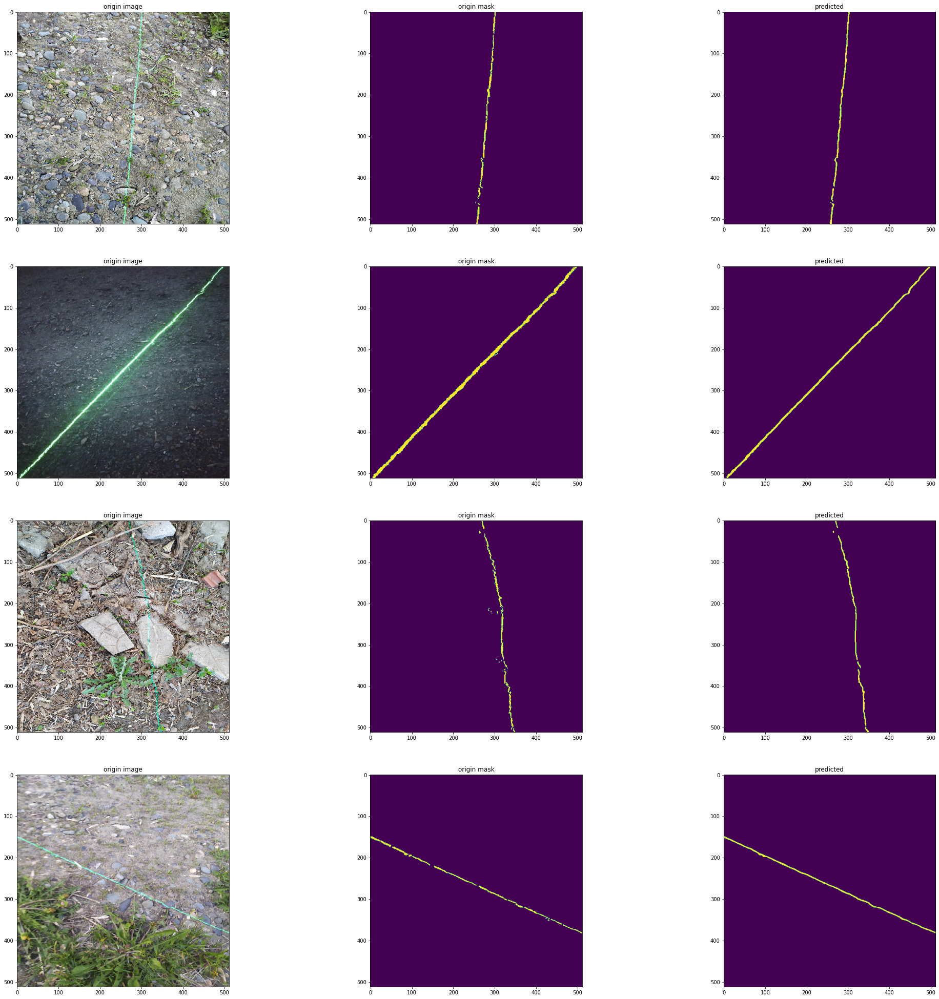

In [ ]:
# Эти данные нейросеть не видела
#model_first.load_weights(r'/content/drive/My Drive/laser_track/resnext50.hdf5')
model_test_visualize(model_first , seed = 1)


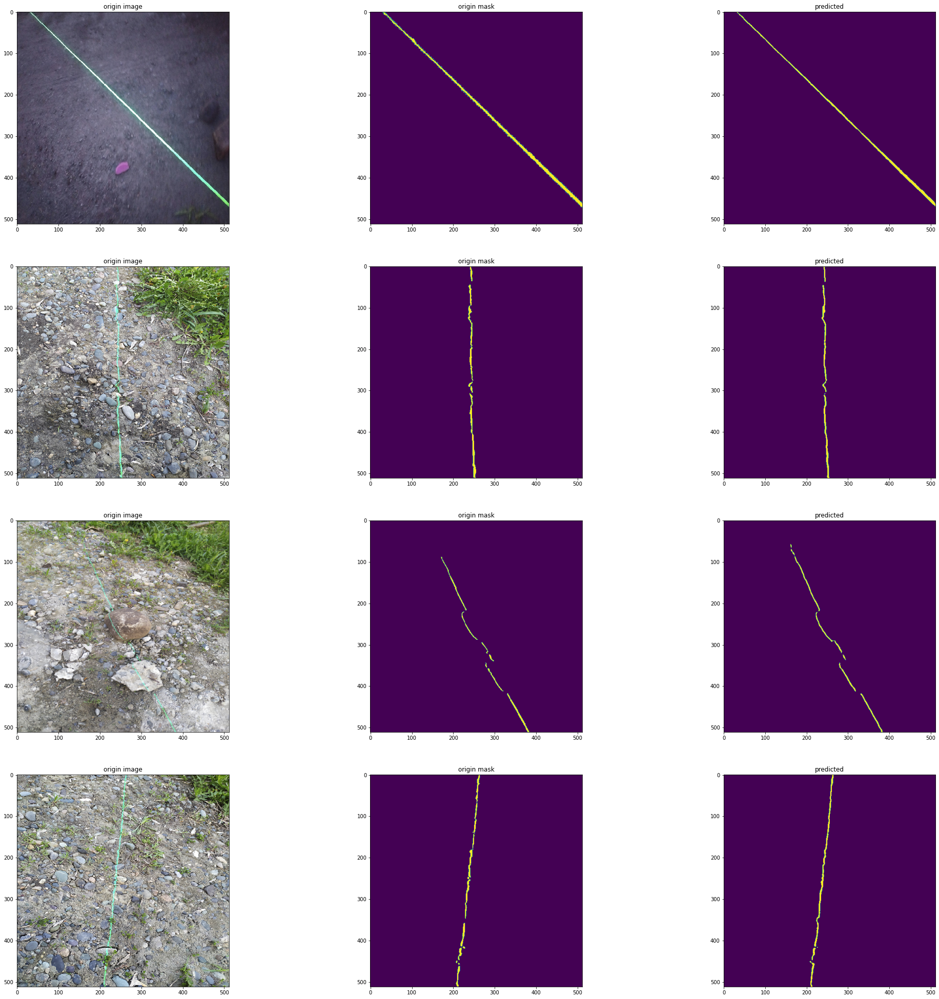

In [ ]:
# Эти данные нейросеть не видела
model_test_visualize(model_first , seed = 6)

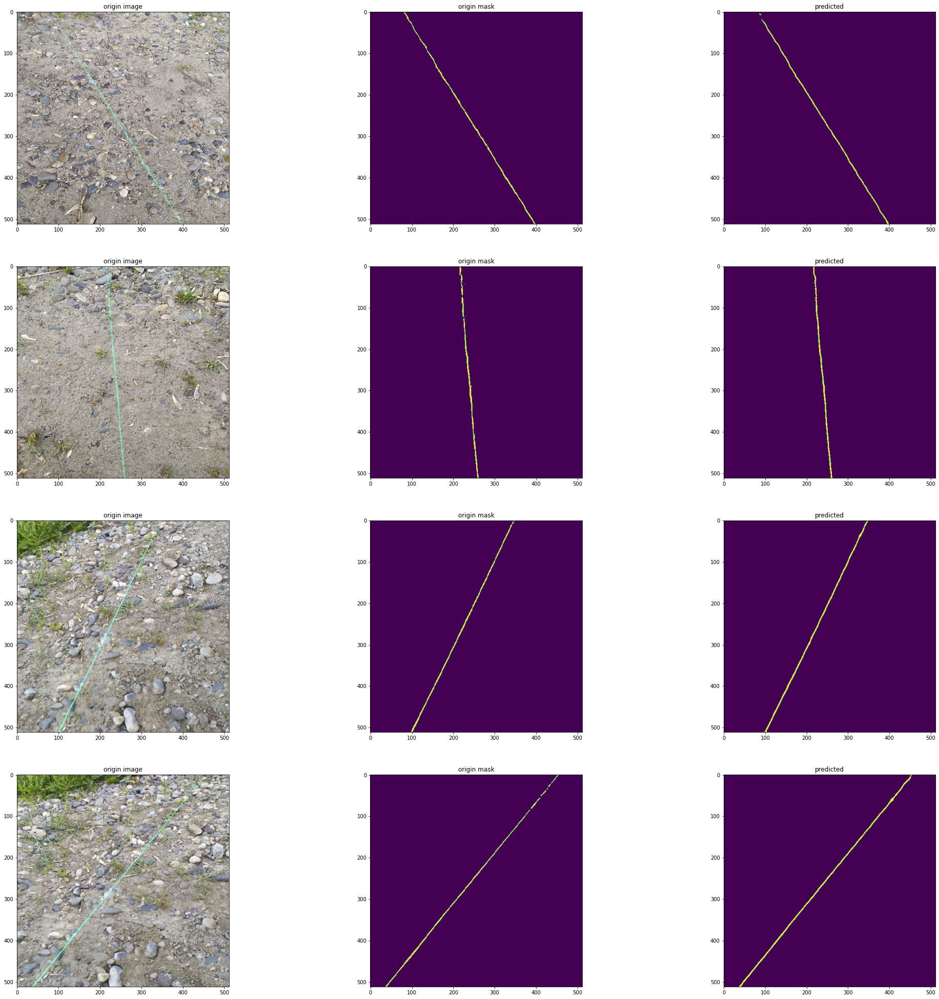

In [ ]:
# Эти данные нейросеть не видела
model_test_visualize(model_first , seed = 3)

In [ ]:
score = model_first.evaluate_generator(test_generator,
                  steps = np.ceil(test_generator_image.samples/ test_generator_image.batch_size),
                  max_queue_size=10, 
                  workers=1, 
                  use_multiprocessing= True, 
                  verbose=0)

print("Loss: {:.5}".format(score[0]))
for metric, value in zip(metrics, score[1:]):
    print("mean {}: {:.5}".format(metric.__name__, value))

Loss: 1.0508
mean iou_score: 0.047963
mean f1-score: 0.0882


In [ ]:
model_unet.load_weights(r"/content/drive/My Drive/laser_track/2resnet50.hdf5")

In [ ]:
test_generator_image[0][0].shape

(512, 512, 3)

In [ ]:
test_image = np.reshape(test_generator_image[0][0], (1,) + test_generator_image[0][0].shape)

In [ ]:
%%time
time_model = model_first.predict(test_image)

array([[[0.69411767, 0.61960787, 0.5882353 ],
        [0.5882353 , 0.5254902 , 0.48235297],
        [0.9176471 , 0.86274517, 0.81568635],
        ...,
        [0.8705883 , 0.8588236 , 0.854902  ],
        [0.7372549 , 0.7137255 , 0.6784314 ],
        [0.43137258, 0.37647063, 0.41960788]],

       [[0.8588236 , 0.78823537, 0.74509805],
        [0.59607846, 0.53333336, 0.48235297],
        [0.7019608 , 0.6509804 , 0.58431375],
        ...,
        [0.8705883 , 0.87843144, 0.8705883 ],
        [0.7019608 , 0.6392157 , 0.62352943],
        [0.9725491 , 1.        , 1.        ]],

       [[0.8745099 , 0.85098046, 0.7725491 ],
        [0.8196079 , 0.79215693, 0.7137255 ],
        [0.6117647 , 0.58431375, 0.5372549 ],
        ...,
        [0.7568628 , 0.70980394, 0.68235296],
        [0.3529412 , 0.3137255 , 0.29411766],
        [0.5019608 , 0.4431373 , 0.427451  ]],

       ...,

       [[0.7058824 , 0.7176471 , 0.64705884],
        [0.70980394, 0.72156864, 0.64705884],
        [0.63529414, 0

## Train with Keras image generator



In [ ]:
model_pre = sm.Unet("vgg16" ,input_shape=(512, 512, 3), classes=1, encoder_weights=r'imagenet',activation='sigmoid')

58892288/58889256 [==============================] - 1s 0us/step


In [ ]:
len(model_pre.layers)

66

In [ ]:
model_pre.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 512, 512, 3)  0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 512, 512, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv2 (Conv2D)           (None, 512, 512, 64) 36928       block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_pool (MaxPooling2D)      (None, 256, 256, 64) 0           block1_conv2[0][0]               
____________________________________________________________________________________________

In [ ]:
checkpoint_path = r"/content/drive/My Drive/laser_track/vgg16_visual.hdf5"

callbacks = [
    keras.callbacks.ModelCheckpoint(checkpoint_path, save_best_only=True, mode='min'),
    keras.callbacks.ReduceLROnPlateau(),
    keras.callbacks.EarlyStopping(monitor='iou_score', patience=30, verbose=0, mode='max'),
]


# define optomizer
optim = keras.optimizers.Adam(lr=0.0001)

# Segmentation models losses can be combined together by '+' and scaled by integer or float factor
dice_loss = sm.losses.DiceLoss()
focal_loss = sm.losses.BinaryFocalLoss()
total_loss = dice_loss + (1 * focal_loss)

metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5)]

# compile keras model with defined optimozer, loss and metrics
model_pre.compile(optim, total_loss, metrics)

In [ ]:
# fit model
# history_pre = model_pre.fit_generator(train_generator,
#                                       steps_per_epoch=image_generator.samples // batch_size,
#                                       epochs=120,
#                                       verbose=1,
#                                       callbacks=callbacks,
#                                       validation_data=valid_generator,
#                                       validation_steps=validation_generator.samples // batch_size,
#                                       class_weight=None,
#                                       max_queue_size=10,
#                                       workers=8,
#                                       validation_freq=1,
#                                       use_multiprocessing=True,
#                                       shuffle=True,
#                                       initial_epoch=0)

history_pre = model_pre.fit_generator(train_dataloader,
    steps_per_epoch=len(train_dataloader),
    epochs=2,
    callbacks=callbacks,
    validation_data=valid_dataloader,
    validation_steps=len(valid_dataloader),
    class_weight=None,
    max_queue_size=10,
    shuffle=True,
    initial_epoch=0)

KeyboardInterrupt: ignored

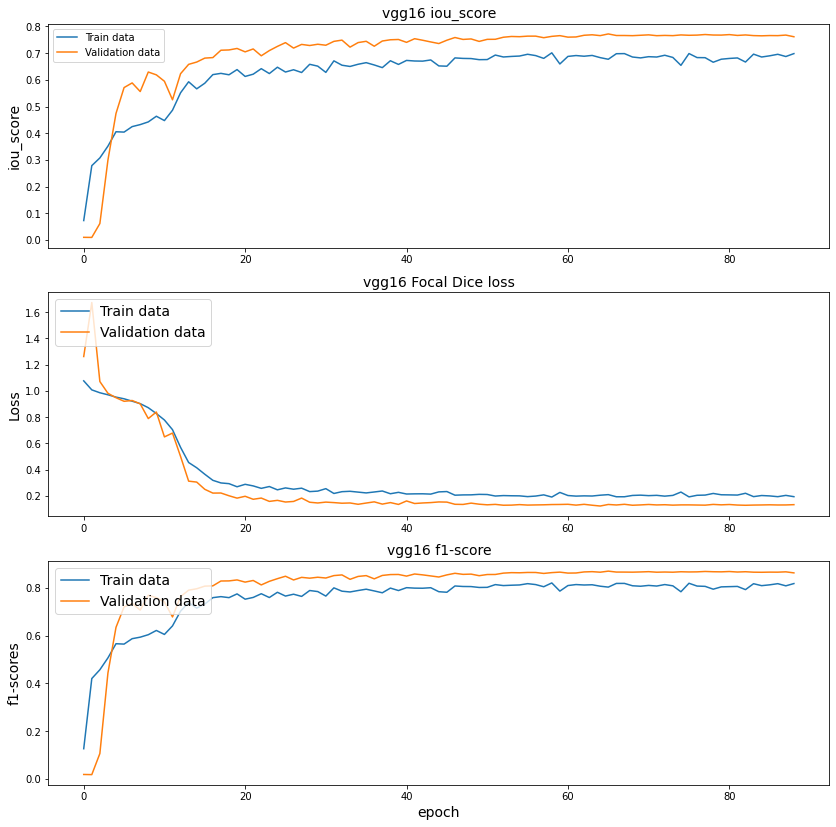

In [ ]:
 history_visualize(history_pre,'vgg16')

In [ ]:

# convert the history.history dict to a pandas DataFrame:     
hist_df = pd.DataFrame(history_pre.history) 

# save to json:  
hist_json_file = '/content/drive/My Drive/laser_track/history_vgg16.json' 
with open(hist_json_file, mode='w') as f:
    hist_df.to_json(f)

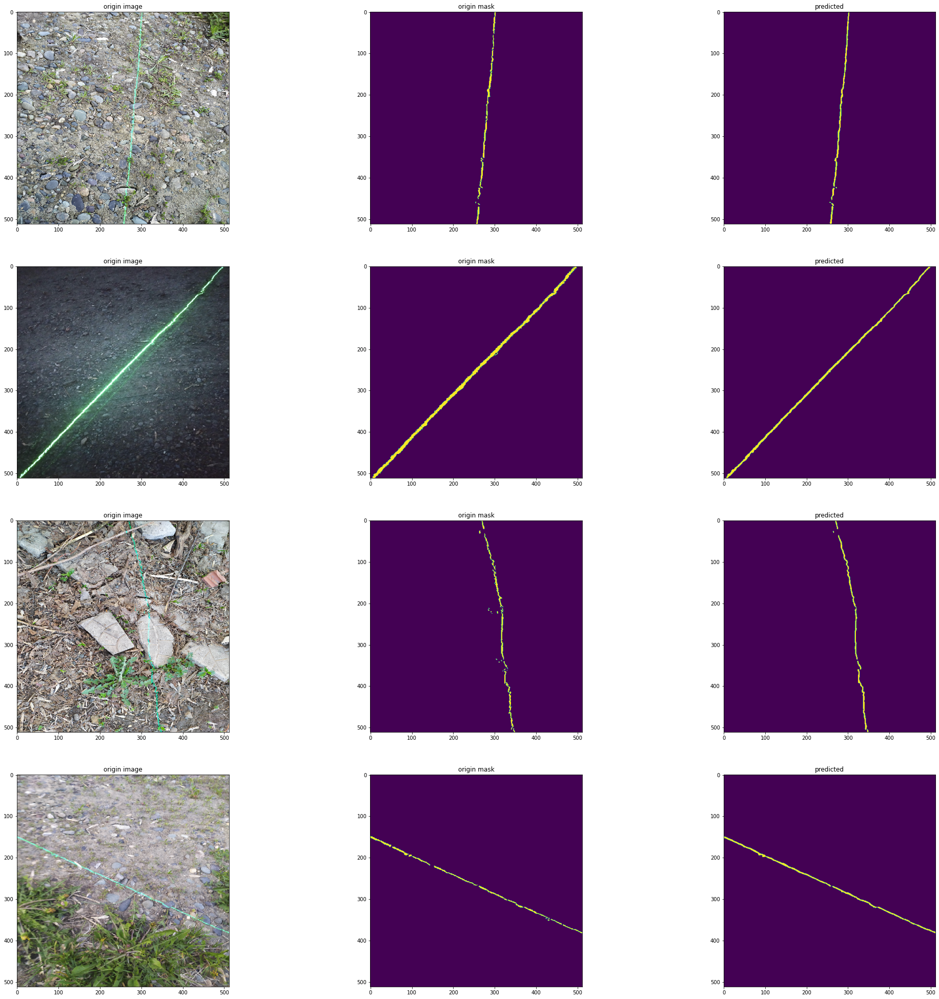

In [ ]:
# Эти данные нейросеть не видела
model_test_visualize(model_pre, seed = 1)

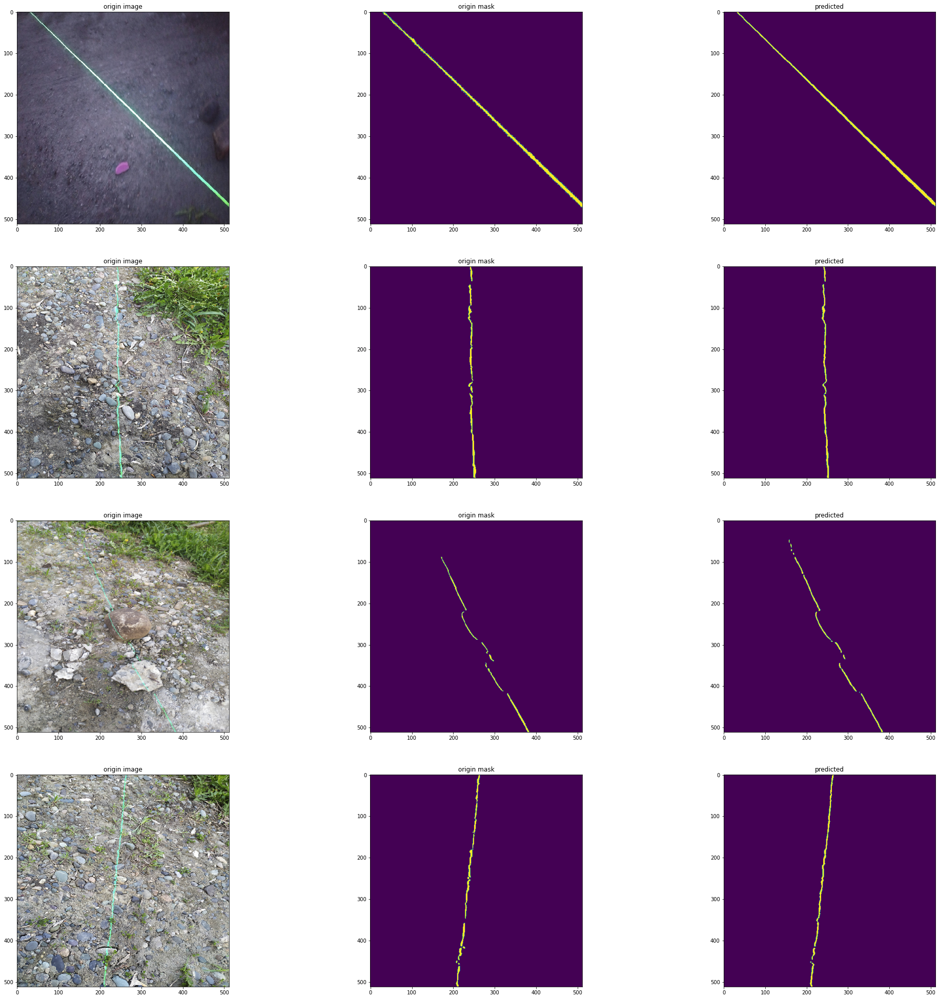

In [ ]:
model_test_visualize(model_pre, seed = 6)

In [ ]:
score = model_pre.evaluate_generator(test_generator,
                  steps = np.ceil(test_generator_image.samples/ test_generator_image.batch_size))

print("Loss: {:.5}".format(score[0]))
for metric, value in zip(metrics, score[1:]):
    print("mean {}: {:.5}".format(metric.__name__, value))

Loss: 0.19856
mean iou_score: 0.73062
mean f1-score: 0.844


In [ ]:
model_pre.load_weights(r"/content/drive/My Drive/laser_track/vgg16_aug.hdf5")

In [ ]:
%%time
  z = model_pre.predict(test_image)

CPU times: user 43.6 ms, sys: 25.8 ms, total: 69.4 ms
Wall time: 153 ms


##  Custom Unet

In [ ]:
# Relevant imports.
%reload_ext tensorboard

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

from datetime import datetime
from packaging import version

In [ ]:
def downsampling(data, num_filters, kernel=(3, 3), padding='same', kernel_initializer='he_normal'):
    conv1 = Conv2D(num_filters, kernel, kernel_initializer=kernel_initializer,
                                padding=padding, activation="relu")(data)
    conv1 = BatchNormalization()(conv1)
    conv1 = Conv2D(num_filters, kernel, kernel_initializer=kernel_initializer,
                                padding=padding, activation="relu")(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    return pool1, conv1


def upsampling(data, down_data, num_filters, kernel=(3, 3), padding='same', kernel_initializer='he_normal'):
    up_s = (UpSampling2D(size=(2, 2))(data))
    merge = concatenate([down_data, up_s], axis=3)
    conv2 = Conv2D(num_filters, 3, activation='relu', padding=padding, kernel_initializer=kernel_initializer)(merge)
    conv2 = BatchNormalization()(conv2)
    conv2 = Conv2D(num_filters, 3, activation='relu', padding=padding, kernel_initializer=kernel_initializer)(conv2)
    conv2 = BatchNormalization()(conv2)
    return conv2


# it's looks like a dilation, but calling bottleneck
def bottleneck(data, filters, padding="same", kernel_initializer='he_normal'):
    bottle_conv = keras.layers.Conv2D(filters, (3, 3), padding=padding, kernel_initializer='he_normal')(data)
    bottle_norm = BatchNormalization()(bottle_conv)
    d1 = Conv2D(filters, (1, 1), dilation_rate=2)(bottle_norm)
    d2 = Conv2D(filters, (1, 1), dilation_rate=4)(d1)
    d3 = Conv2D(filters, (1, 1), dilation_rate=8)(d2)
    conv = keras.layers.Concatenate()([d1, d2, d3])
    return conv


In [ ]:
def custom_Unet(height=512, width=512):
    Step = [8, 16, 32, 64, 128, 256, 512]
    input = keras.layers.Input((height, width, 3))

    pool1, conv1 = downsampling(input, Step[0])  # 512 -> 256
    pool2, conv2 = downsampling(pool1, Step[1])  # 256 -> 128
    pool3, conv3 = downsampling(pool2, Step[2])  # 128 -> 64
    pool4, conv4 = downsampling(pool3, Step[3])  # 64 -> 32
    pool5, conv5 = downsampling(pool4, Step[4])  # 32 -> 16
    pool6, conv6 = downsampling(pool5, Step[5])  # 16 -> 8

    bottle_neck = bottleneck(pool6, Step[6])

    up1 = upsampling(bottle_neck, conv6, Step[5])  # 8 -> 16
    up2 = upsampling(up1, conv5, Step[4])  # 16 -> 32
    up3 = upsampling(up2, conv4, Step[3])  # 32 -> 64
    up4 = upsampling(up3, conv3, Step[2])  # 64 -> 128
    up5 = upsampling(up4, conv2, Step[1])  # 128 -> 256
    up6 = upsampling(up5, conv1, Step[0])  # 256 -> 512

    output = keras.layers.Conv2D(1, (1, 1), padding="same", activation="sigmoid")(up6)
    return keras.models.Model(input, output)


In [ ]:
model_unet = custom_Unet()
#fmodel_unet.summary()


In [ ]:
model_unet.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            (None, 512, 512, 3)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 512, 512, 8)  224         input_2[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 512, 512, 8)  32          conv2d_1[0][0]                   
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 512, 512, 8)  584         batch_normalization_1[0][0]      
____________________________________________________________________________________________

In [ ]:
checkpoint_path = r"/content/drive/My Drive/laser_track/Unet1_custom_visual.hdf5"

callbacks = [
    keras.callbacks.ModelCheckpoint(checkpoint_path, save_best_only=True, mode='min'),
    keras.callbacks.ReduceLROnPlateau(),
    keras.callbacks.EarlyStopping(monitor='iou_score', patience=30, verbose=0, mode='max')
]


# define optomizer
optim = keras.optimizers.Adam(lr=0.0001)

# Segmentation models losses can be combined together by '+' and scaled by integer or float factor
dice_loss = sm.losses.DiceLoss()
focal_loss = sm.losses.BinaryFocalLoss()
total_loss = dice_loss + (1 * focal_loss)

metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5)]

# compile keras model with defined optimozer, loss and metrics
model_unet.compile(optim, total_loss, metrics)


In [ ]:
# (train_images, train_labels), _ = keras.datasets.fashion_mnist.load_data()
# train_images = train_images / 255.0

In [ ]:
history_unet = model_unet.fit_generator(
    train_dataloader, 
    steps_per_epoch=len(train_dataloader), 
    epochs=120, 
    callbacks= callbacks, 
    validation_data=valid_dataloader, 
    validation_steps=len(valid_dataloader),
    class_weight=None,
    # max_queue_size= 10,
    # workers= 2,
    # validation_freq=1,
    # use_multiprocessing=True,
    shuffle=True,
    initial_epoch=0)

Epoch 1/120
78/78 [==============================] - 54s 689ms/step - loss: 1.1912 - iou_score: 0.0098 - f1-score: 0.0194 - val_loss: 1.0771 - val_iou_score: 0.0060 - val_f1-score: 0.0120
Epoch 2/120
78/78 [==============================] - 46s 587ms/step - loss: 1.1173 - iou_score: 0.0108 - f1-score: 0.0214 - val_loss: 1.0938 - val_iou_score: 0.0085 - val_f1-score: 0.0169
Epoch 3/120
78/78 [==============================] - 52s 667ms/step - loss: 1.1024 - iou_score: 0.0128 - f1-score: 0.0252 - val_loss: 1.0935 - val_iou_score: 0.0093 - val_f1-score: 0.0184
Epoch 4/120
78/78 [==============================] - 55s 710ms/step - loss: 1.0928 - iou_score: 0.0159 - f1-score: 0.0311 - val_loss: 1.1131 - val_iou_score: 0.0108 - val_f1-score: 0.0212
Epoch 5/120
78/78 [==============================] - 49s 634ms/step - loss: 1.0859 - iou_score: 0.0199 - f1-score: 0.0389 - val_loss: 1.1048 - val_iou_score: 0.0115 - val_f1-score: 0.0227
Epoch 6/120
78/78 [==============================] - 51s 658

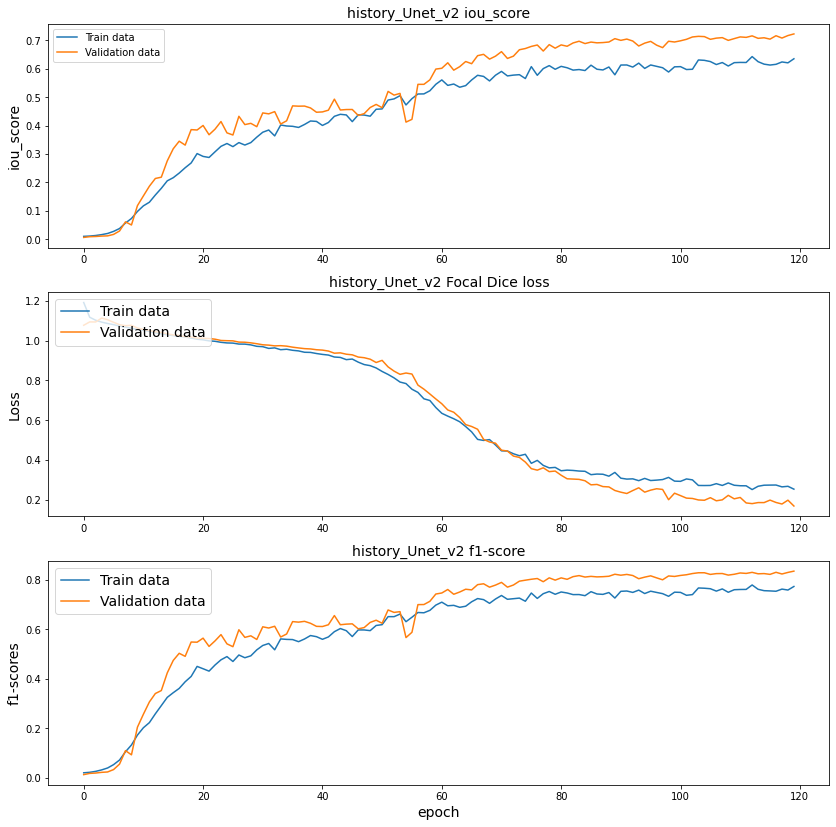

In [ ]:
history_visualize(history_unet,'history_Unet_v2')

In [ ]:


# convert the history.history dict to a pandas DataFrame:     
hist_df = pd.DataFrame(history_unet.history) 

# save to json:  
hist_json_file = '/content/drive/My Drive/laser_track/history_unet_v2.json' 
with open(hist_json_file, mode='w') as f:
    hist_df.to_json(f)

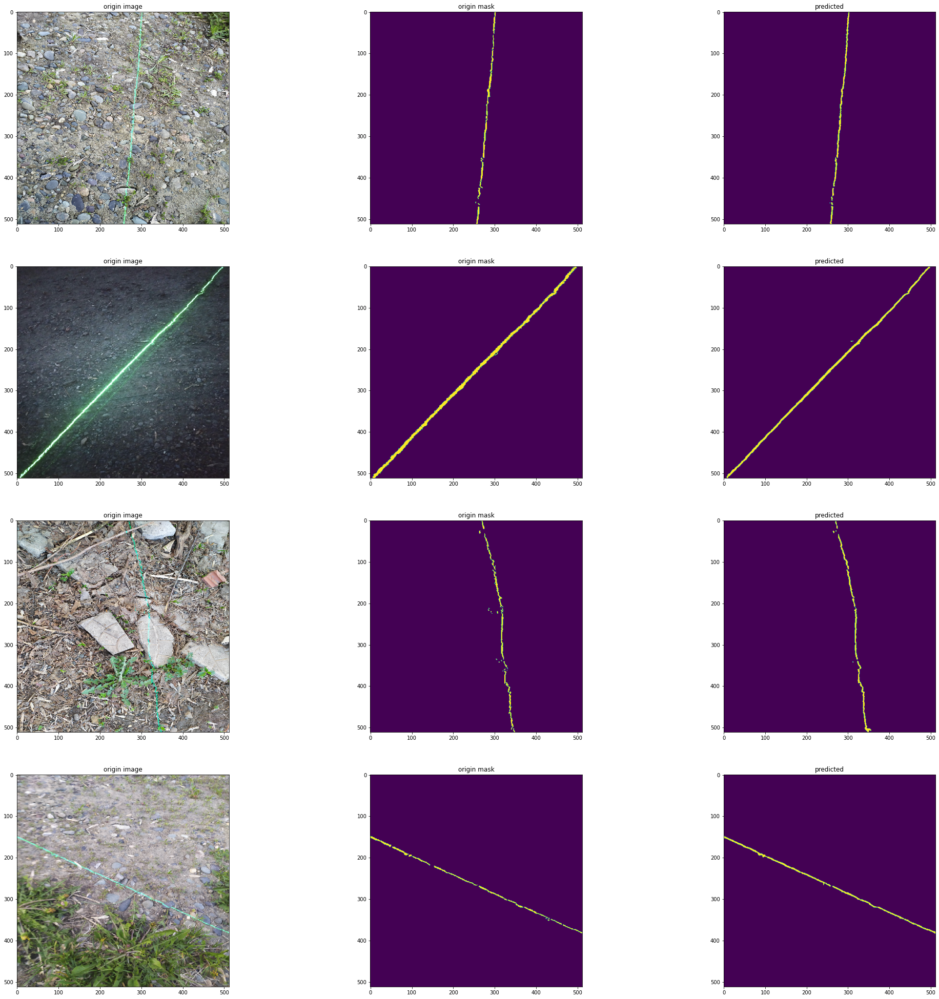

In [ ]:
model_test_visualize(model_unet, seed = 1)

In [ ]:
#model_unet.load_weights('/content/drive/My Drive/laser_track/Unet1_custom.hdf5')
score = model_unet.evaluate_generator(test_generator,
                  steps = np.ceil(test_generator_image.samples/ test_generator_image.batch_size))

print("Loss : {:.5}".format(score[0]))
for metric, value in zip(metrics, score[1:]):
    print("mean {}: {:.5}".format(metric.__name__, value))

Loss : 0.19886
mean iou_score: 0.73988
mean f1-score: 0.85


In [ ]:
tf.test.is_gpu_available(
    cuda_only=False, min_cuda_compute_capability=None
)

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.


False

In [ ]:
model_unet.load_weights(r"/content/drive/My Drive/laser_track/Unet1_custom.hdf5")

In [ ]:
model_unet_11 = keras.models.load_model(r"/content/drive/My Drive/laser_track/Unet1_custom.hdf5", compile=False)

In [ ]:
%%time 
for i in range(100):
 time_model = model_unet.predict(test_image)

CPU times: user 1.98 s, sys: 792 ms, total: 2.77 s
Wall time: 2.68 s


In [ ]:
%%time 
score = model_unet.evaluate_generator(test_generator,
                  steps = 4)

CPU times: user 751 ms, sys: 59.4 ms, total: 810 ms
Wall time: 798 ms


In [ ]:
!cat /proc/cpuinfo

processor	: 0
vendor_id	: GenuineIntel
cpu family	: 6
model		: 63
model name	: Intel(R) Xeon(R) CPU @ 2.30GHz
stepping	: 0
microcode	: 0x1
cpu MHz		: 2300.000
cache size	: 46080 KB
physical id	: 0
siblings	: 2
core id		: 0
cpu cores	: 1
apicid		: 0
initial apicid	: 0
fpu		: yes
fpu_exception	: yes
cpuid level	: 13
wp		: yes
flags		: fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cmov pat pse36 clflush mmx fxsr sse sse2 ss ht syscall nx pdpe1gb rdtscp lm constant_tsc rep_good nopl xtopology nonstop_tsc cpuid tsc_known_freq pni pclmulqdq ssse3 fma cx16 pcid sse4_1 sse4_2 x2apic movbe popcnt aes xsave avx f16c rdrand hypervisor lahf_lm abm invpcid_single ssbd ibrs ibpb stibp fsgsbase tsc_adjust bmi1 avx2 smep bmi2 erms invpcid xsaveopt arat md_clear arch_capabilities
bugs		: cpu_meltdown spectre_v1 spectre_v2 spec_store_bypass l1tf mds swapgs itlb_multihit
bogomips	: 4600.00
clflush size	: 64
cache_alignment	: 64
address sizes	: 46 bits physical, 48 bits virtual
power management

In [ ]:
model_pre.summary()

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 512, 512, 3)  0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 512, 512, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv2 (Conv2D)           (None, 512, 512, 64) 36928       block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_pool (MaxPooling2D)      (None, 256, 256, 64) 0           block1_conv2[0][0]               
____________________________________________________________________________________________

## MobileNetV2

In [ ]:
# Данная модель может быть использована для расчетах на мобильных устройствах 
# Её скороть работы наиболее высокая среди всех моделей (малое число нейронов)
model_mobilenet_v2 = MobileNetV2(
    input_shape=(512,512,3),
    alpha=1.0,
    include_top= False,
    weights='imagenet',
    input_tensor=None,
    pooling=None,
    classes=1,
)

/usr/local/lib/python3.6/dist-packages/keras_applications/mobilenet_v2.py:294: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  warnings.warn('`input_shape` is undefined or non-square, '


In [ ]:
uper = UpSampling2D(size=(4, 4),)(model_mobilenet_v2.get_layer('out_relu').output) # 16 * 4 = 64
conv = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(uper)
concat_1 = keras.layers.Concatenate()([model_mobilenet_v2.get_layer('block_3_depthwise').output, conv ])
f = BatchNormalization()(concat_1)
uper = UpSampling2D(size=(4, 4),)(f) # 64 * 4 = 256
conv = Conv2D(16, 3, activation='relu', padding='same', kernel_initializer='he_normal')(uper)
concat_2 = keras.layers.Concatenate()([model_mobilenet_v2.get_layer('Conv1').output, conv ]) 
f = BatchNormalization()(concat_2)
end_up = UpSampling2D(size=(2, 2),)((f)) # 256 * 2
output_mob = keras.layers.Conv2D(1, (1, 1), padding="same", activation="sigmoid")(end_up)


model_mobilenet_v2 = Model(input=model_mobilenet_v2.input, output=output_mob)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("co...)`
  del sys.path[0]


In [ ]:
checkpoint_path = r"/content/drive/My Drive/laser_track/mobile_v2.hdf5"

callbacks = [
    keras.callbacks.ModelCheckpoint(checkpoint_path, save_best_only=True, mode='min'),
    keras.callbacks.ReduceLROnPlateau(),
]


# define optomizer
optim = keras.optimizers.Adam(lr=0.0001)

# Segmentation models losses can be combined together by '+' and scaled by integer or float factor
dice_loss = sm.losses.DiceLoss()
focal_loss = sm.losses.BinaryFocalLoss()
total_loss = dice_loss + (1 * focal_loss)

metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5)]

# compile keras model with defined optimozer, loss and metrics
model_mobilenet_v2.compile(optim, total_loss, metrics)


In [ ]:
history_mobile = model_mobilenet_v2.fit_generator(
    train_dataloader, 
    steps_per_epoch=len(train_dataloader), 
    epochs=100, 
    callbacks=callbacks, 
    validation_data=valid_dataloader, 
    validation_steps=len(valid_dataloader),
    class_weight=None,
    # max_queue_size= 10,
    # workers= 8,
    # validation_freq=1,
    # use_multiprocessing=True,
    shuffle=True,
    initial_epoch=0)

Epoch 1/100
78/78 [==============================] - 657s 8s/step - loss: 1.1652 - iou_score: 0.0083 - f1-score: 0.0164 - val_loss: 1.1034 - val_iou_score: 0.0152 - val_f1-score: 0.0299
Epoch 2/100
78/78 [==============================] - 51s 655ms/step - loss: 1.1179 - iou_score: 0.0121 - f1-score: 0.0239 - val_loss: 1.0974 - val_iou_score: 0.0194 - val_f1-score: 0.0377
Epoch 3/100
78/78 [==============================] - 48s 621ms/step - loss: 1.0945 - iou_score: 0.0190 - f1-score: 0.0370 - val_loss: 1.0807 - val_iou_score: 0.0269 - val_f1-score: 0.0517
Epoch 4/100
78/78 [==============================] - 50s 639ms/step - loss: 1.0768 - iou_score: 0.0327 - f1-score: 0.0628 - val_loss: 1.0705 - val_iou_score: 0.0364 - val_f1-score: 0.0691
Epoch 5/100
78/78 [==============================] - 58s 741ms/step - loss: 1.0641 - iou_score: 0.0564 - f1-score: 0.1055 - val_loss: 1.0553 - val_iou_score: 0.0683 - val_f1-score: 0.1252
Epoch 6/100
78/78 [==============================] - 50s 635ms

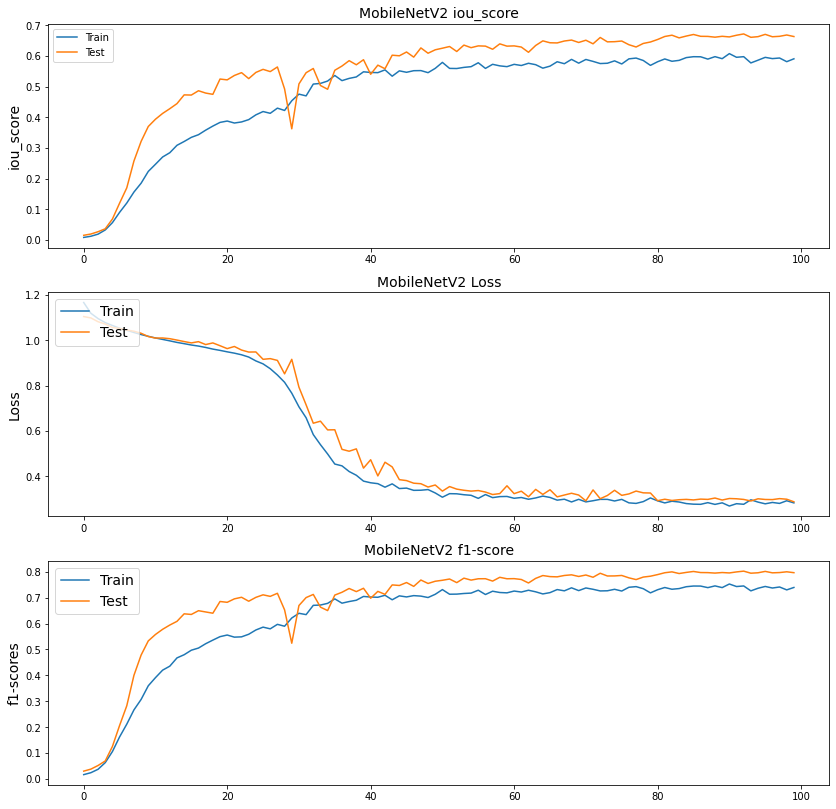

In [ ]:
history_visualize(history_mobile,'MobileNetV2')

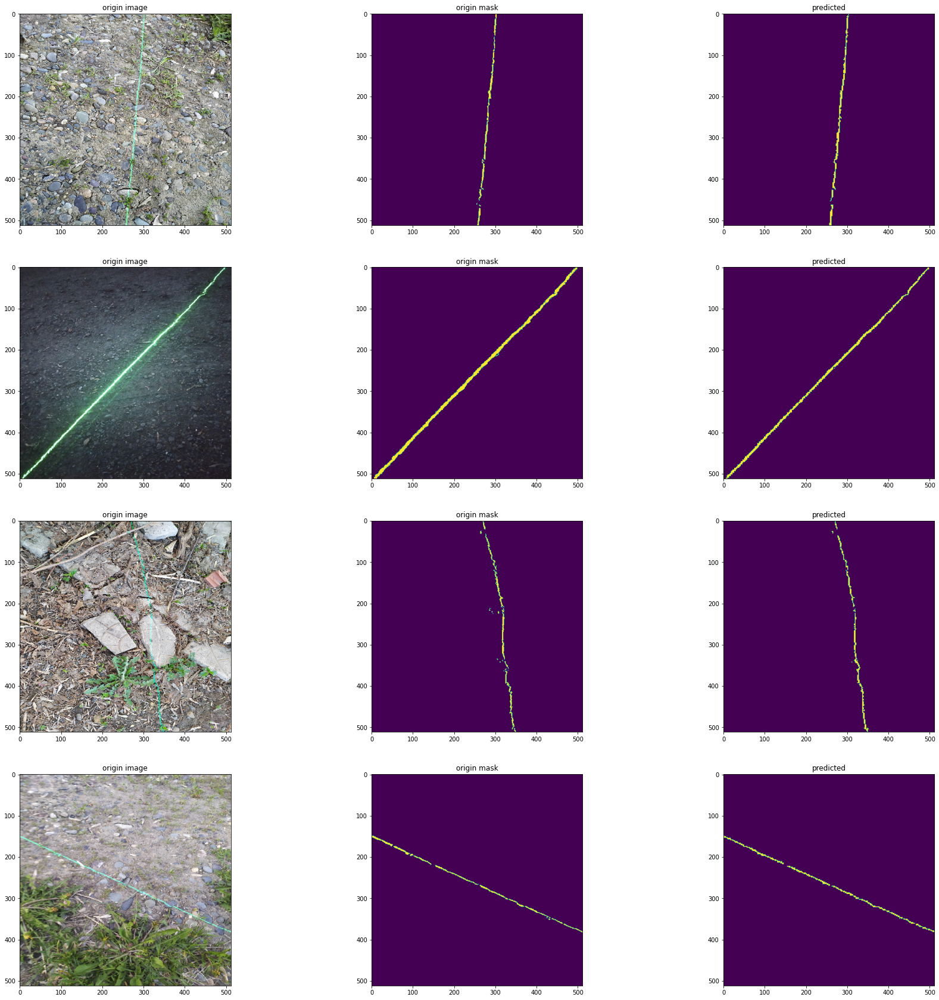

In [ ]:
model_test_visualize(model_mobilenet_v2, seed = 1)

In [ ]:
score = model_mobilenet_v2.evaluate_generator(test_generator,
                  steps = np.ceil(test_generator_image.samples/ test_generator_image.batch_size))

print("Loss : {:.5}".format(score[0]))
for metric, value in zip(metrics, score[1:]):
    print("mean {}: {:.5}".format(metric.__name__, value))

Loss : 0.24278
mean iou_score: 0.6501
mean f1-score: 0.78766


In [ ]:
%%time

time_model  = model_mobilenet_v2.predict(test_generator_image[0])                   

CPU times: user 152 ms, sys: 19 ms, total: 171 ms
Wall time: 178 ms


In [ ]:
!cat /proc/cpuinfo

processor	: 0
vendor_id	: GenuineIntel
cpu family	: 6
model		: 63
model name	: Intel(R) Xeon(R) CPU @ 2.30GHz
stepping	: 0
microcode	: 0x1
cpu MHz		: 2300.000
cache size	: 46080 KB
physical id	: 0
siblings	: 2
core id		: 0
cpu cores	: 1
apicid		: 0
initial apicid	: 0
fpu		: yes
fpu_exception	: yes
cpuid level	: 13
wp		: yes
flags		: fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cmov pat pse36 clflush mmx fxsr sse sse2 ss ht syscall nx pdpe1gb rdtscp lm constant_tsc rep_good nopl xtopology nonstop_tsc cpuid tsc_known_freq pni pclmulqdq ssse3 fma cx16 pcid sse4_1 sse4_2 x2apic movbe popcnt aes xsave avx f16c rdrand hypervisor lahf_lm abm invpcid_single ssbd ibrs ibpb stibp fsgsbase tsc_adjust bmi1 avx2 smep bmi2 erms invpcid xsaveopt arat md_clear arch_capabilities
bugs		: cpu_meltdown spectre_v1 spectre_v2 spec_store_bypass l1tf mds swapgs itlb_multihit
bogomips	: 4600.00
clflush size	: 64
cache_alignment	: 64
address sizes	: 46 bits physical, 48 bits virtual
power management

In [ ]:
# model_pre
# model_unet
# model_first

In [ ]:
model_unet.summary()

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 512, 512, 3)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 512, 512, 8)  224         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 512, 512, 8)  32          conv2d_1[0][0]                   
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 512, 512, 8)  584         batch_normalization_1[0][0]      
____________________________________________________________________________________________